In [1]:
import pandas as pd
from graph_utilities import GraphUtilities

In [28]:
csv_route="../Data/model_output_all_kpoint_total_dos_epoch_401_432_batches.csv"
dataset = pd.read_csv(csv_route, header=None, index_col=0).iloc[:,216:].T
# dataset = dataset.sample(n=500, axis="columns", random_state=6)

In [29]:
dataset

,mp-1217193,mp-675230,mp-710,mp-20753,mp-7128,mp-1009878,mp-1216447,mvc-7237,mp-3886,mp-569790,...,mp-30465,mp-12996,mp-1187519,mp-862423,mp-23199,mp-1079697,mp-8436,mp-1028488,mp-30377,mp-16264
217,1.268794,1.144706,0.549433,1.712098,0.464295,0.349453,1.185230,1.105623,2.396037,1.437942,...,0.445478,0.739435,0.472545,1.067485,0.667895,1.959806,0.896578,0.872208,0.474780,2.673518
218,1.225051,1.175448,0.496400,1.704534,0.460004,0.328972,1.122782,1.127762,2.360086,1.335754,...,0.452802,0.731209,0.478289,0.970109,0.781045,1.926283,0.888745,0.880126,0.479816,2.604301
219,1.197903,1.217178,0.451216,1.691775,0.454960,0.312944,1.067724,1.149260,2.326248,1.255516,...,0.465429,0.725474,0.486698,0.883036,0.934639,1.898615,0.891450,0.900959,0.490003,2.560473
220,1.185577,1.266045,0.413550,1.674087,0.449541,0.301068,1.021013,1.169472,2.293581,1.196803,...,0.482519,0.722360,0.497593,0.806986,1.137438,1.877686,0.903268,0.931368,0.504764,2.539438
221,1.185074,1.317836,0.383171,1.652111,0.444135,0.292656,0.982259,1.187250,2.258841,1.156681,...,0.502425,0.721031,0.510217,0.739424,1.396295,1.862252,0.921648,0.967679,0.522812,2.536002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
512,1.952413,0.721393,0.716627,1.440723,2.257501,0.362870,0.631947,1.374335,1.589009,1.749298,...,0.694997,1.044564,0.883462,1.329828,1.898513,2.099015,2.273670,2.712863,0.758261,0.324411
513,0.297157,0.159255,0.057726,0.277154,0.259705,0.134373,0.186220,0.394342,0.145706,0.690553,...,0.387847,0.210841,0.275396,0.177104,1.273725,0.342531,0.228288,0.155942,0.078789,0.164105
514,0.207508,0.086398,0.040597,0.171220,0.178222,0.080149,0.132761,0.285660,0.102150,0.443032,...,0.181819,0.097676,0.140910,0.104900,0.618102,0.228516,0.141975,0.111046,0.046380,0.097574
515,0.052398,0.064145,0.066819,0.084722,0.075570,0.189509,0.048994,0.122155,0.068804,0.153141,...,0.101939,0.039793,0.028260,0.077806,0.119554,0.132965,0.067358,0.039553,0.029299,0.038872


In [30]:
graph_utils = GraphUtilities(materials_df=dataset)

In [32]:
graph_utils.calculate_diff_matrix()

100%|██████████| 3450/3450 [00:17<00:00, 191.73it/s] 


## Test different calculation methods and percentages

##### Exponential a=5, b=1, top 5 connections per material

100%|██████████| 2000/2000 [02:09<00:00, 15.47it/s]


BarnesHut Approximation  took  38.90  seconds
Repulsion forces  took  84.15  seconds
Gravitational forces  took  0.67  seconds
Attraction forces  took  0.46  seconds
AdjustSpeedAndApplyForces step  took  2.49  seconds


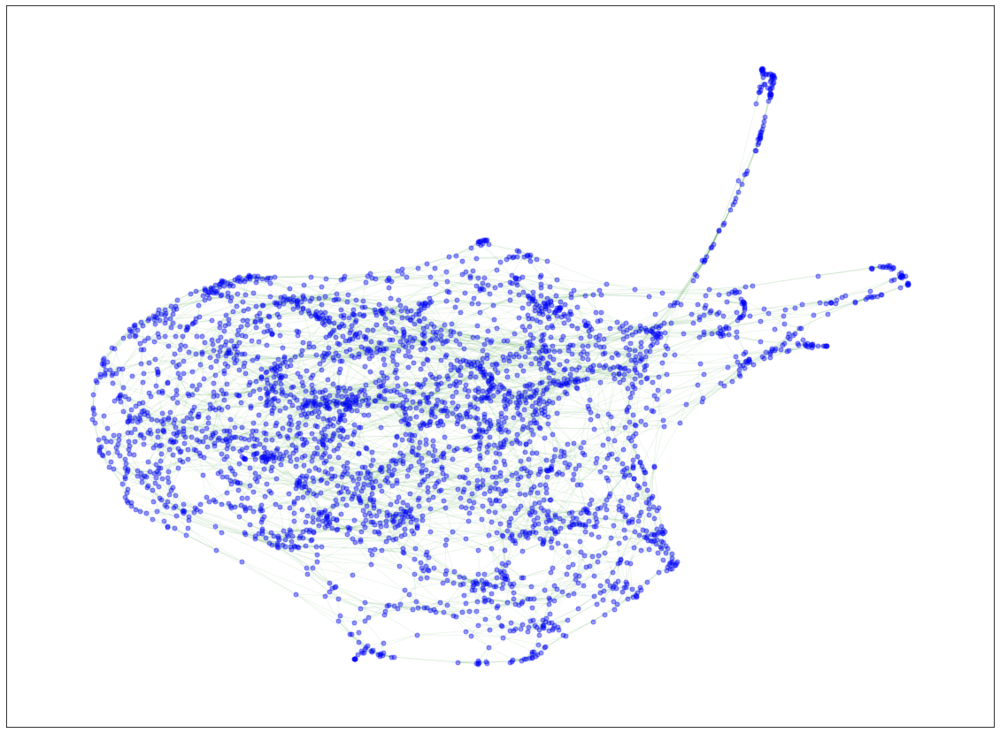

In [33]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(method="keep_weights_per_material", keep_weights_per_material=5)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=1, top 5 connections per material

In [ ]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(method="keep_weights_per_material", keep_weights_per_material=5)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.5% connections

100%|██████████| 2000/2000 [05:07<00:00,  6.51it/s]


BarnesHut Approximation  took  56.67  seconds
Repulsion forces  took  100.89  seconds
Gravitational forces  took  0.71  seconds
Attraction forces  took  141.82  seconds
AdjustSpeedAndApplyForces step  took  2.89  seconds


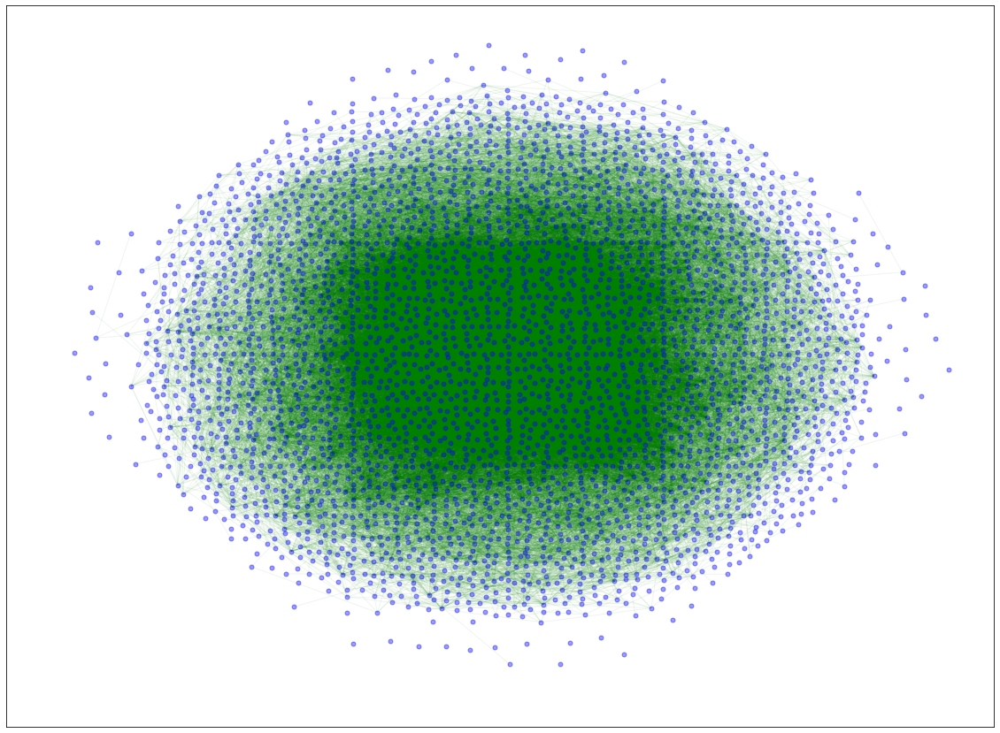

In [6]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.5)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 2000 iterations

100%|██████████| 2000/2000 [05:07<00:00,  6.50it/s]


BarnesHut Approximation  took  58.43  seconds
Repulsion forces  took  101.22  seconds
Gravitational forces  took  0.64  seconds
Attraction forces  took  140.77  seconds
AdjustSpeedAndApplyForces step  took  2.69  seconds


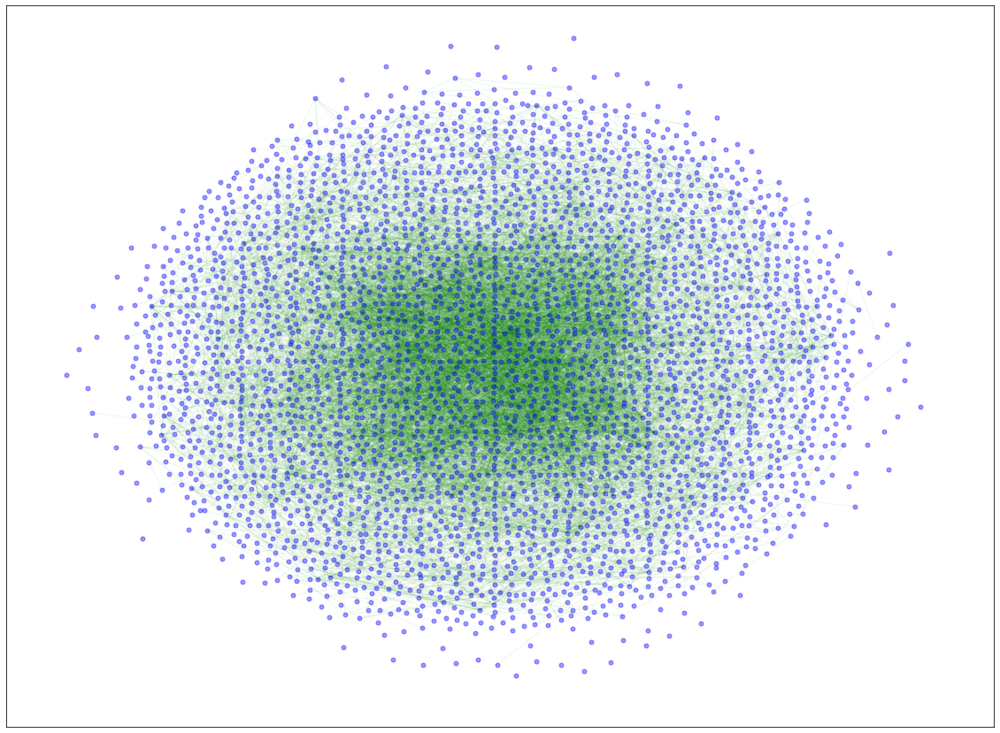

In [7]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 4000 iterations

100%|██████████| 4000/4000 [10:11<00:00,  6.54it/s]


BarnesHut Approximation  took  114.62  seconds
Repulsion forces  took  199.05  seconds
Gravitational forces  took  1.29  seconds
Attraction forces  took  283.73  seconds
AdjustSpeedAndApplyForces step  took  5.48  seconds


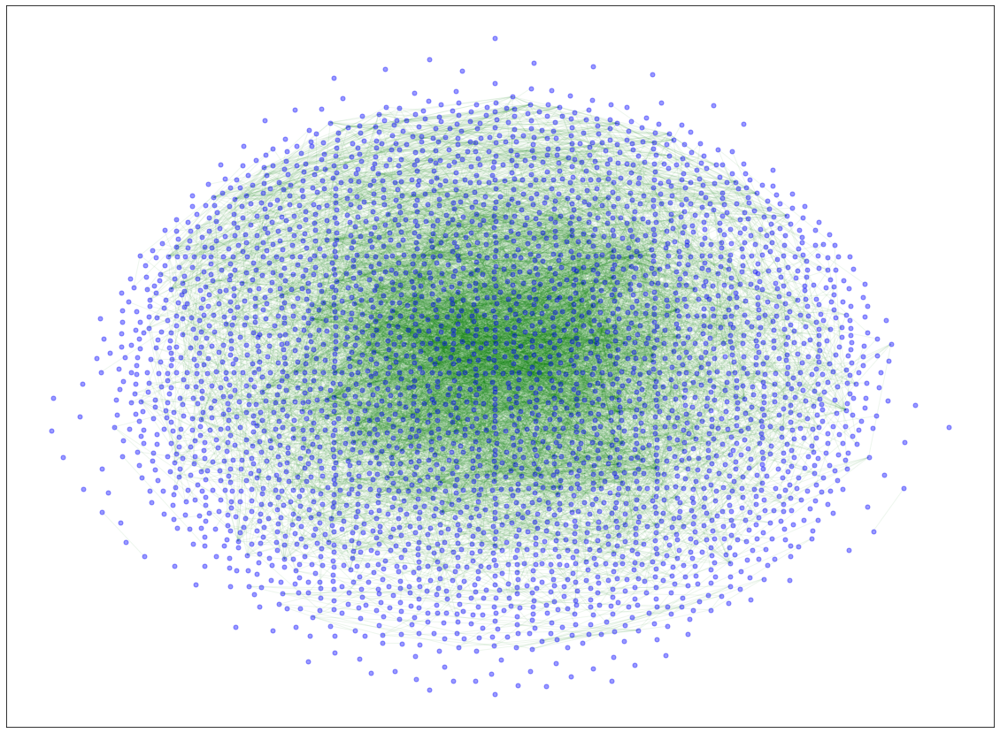

In [8]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions(number_iterations=4000)
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 6000 iterations

100%|██████████| 6000/6000 [16:24<00:00,  6.10it/s]


BarnesHut Approximation  took  198.46  seconds
Repulsion forces  took  309.28  seconds
Gravitational forces  took  2.06  seconds
Attraction forces  took  453.85  seconds
AdjustSpeedAndApplyForces step  took  8.29  seconds


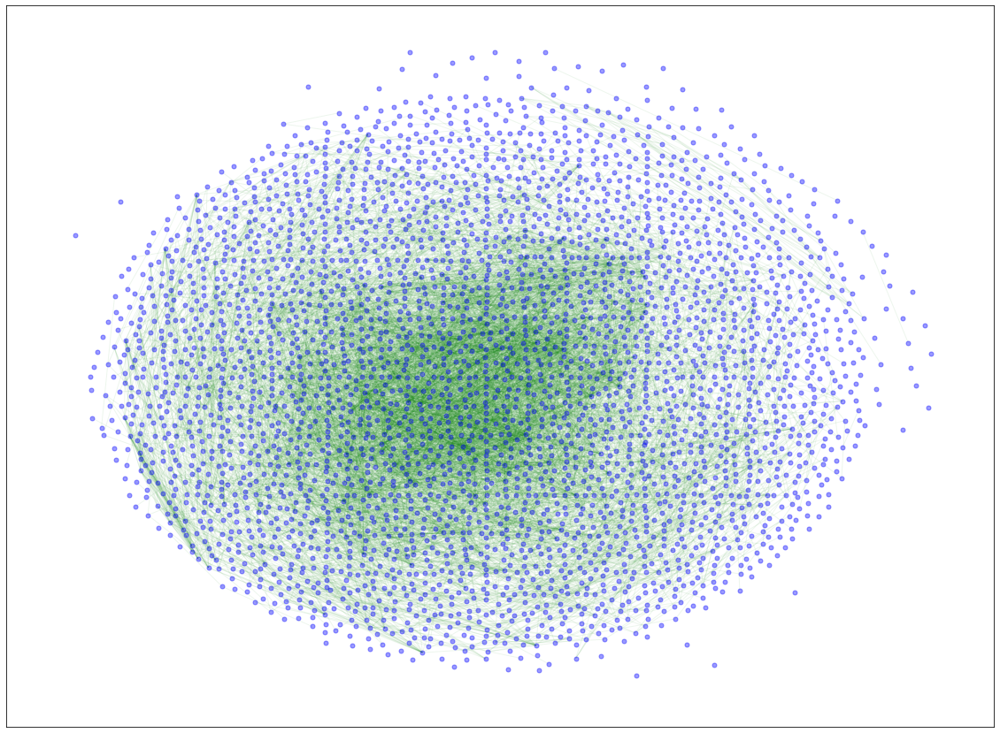

In [9]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions(number_iterations=6000)
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 8000 iterations

100%|██████████| 8000/8000 [20:39<00:00,  6.45it/s]


BarnesHut Approximation  took  233.72  seconds
Repulsion forces  took  406.29  seconds
Gravitational forces  took  2.67  seconds
Attraction forces  took  569.59  seconds
AdjustSpeedAndApplyForces step  took  11.25  seconds


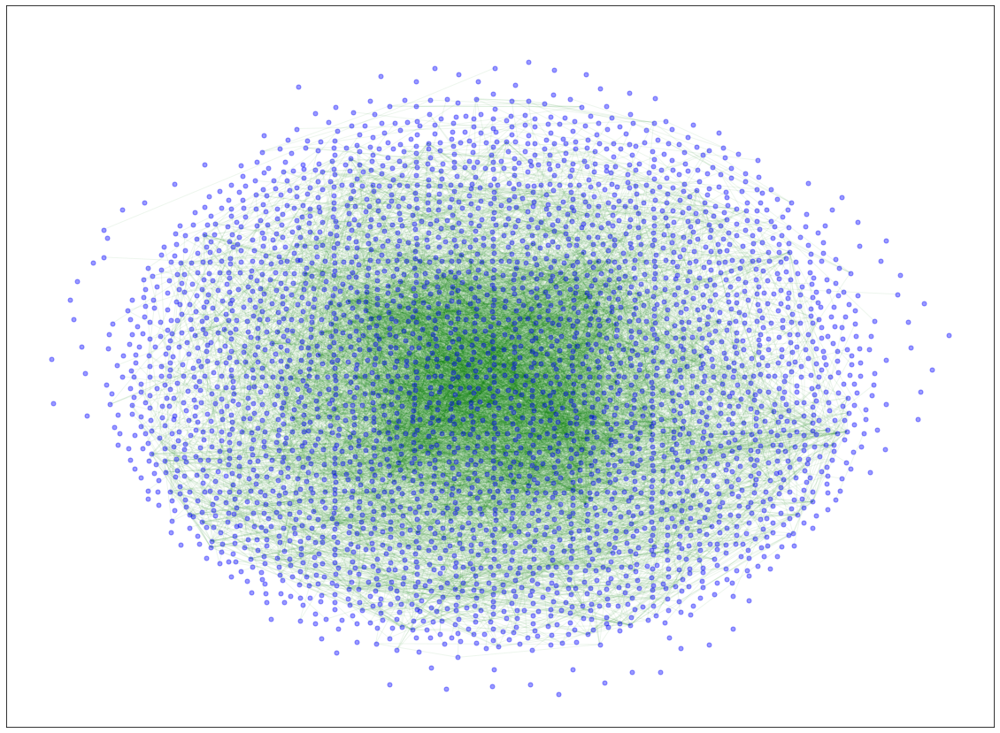

In [10]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions(number_iterations=8000)
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 10000 iterations

100%|██████████| 10000/10000 [30:03<00:00,  5.54it/s]


BarnesHut Approximation  took  325.47  seconds
Repulsion forces  took  508.34  seconds
Gravitational forces  took  3.40  seconds
Attraction forces  took  932.06  seconds
AdjustSpeedAndApplyForces step  took  14.41  seconds


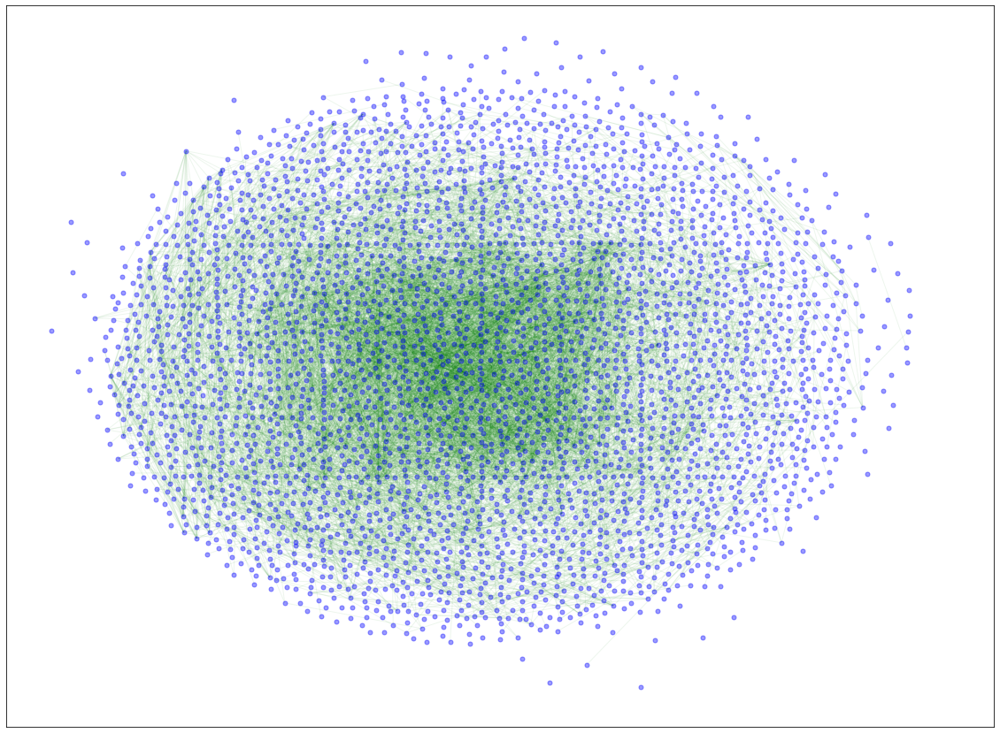

In [33]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions(number_iterations=10000)
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.1% connections, 15000 iterations

100%|██████████| 15000/15000 [38:42<00:00,  6.46it/s]


BarnesHut Approximation  took  433.91  seconds
Repulsion forces  took  711.71  seconds
Gravitational forces  took  4.66  seconds
Attraction forces  took  1122.92  seconds
AdjustSpeedAndApplyForces step  took  20.43  seconds


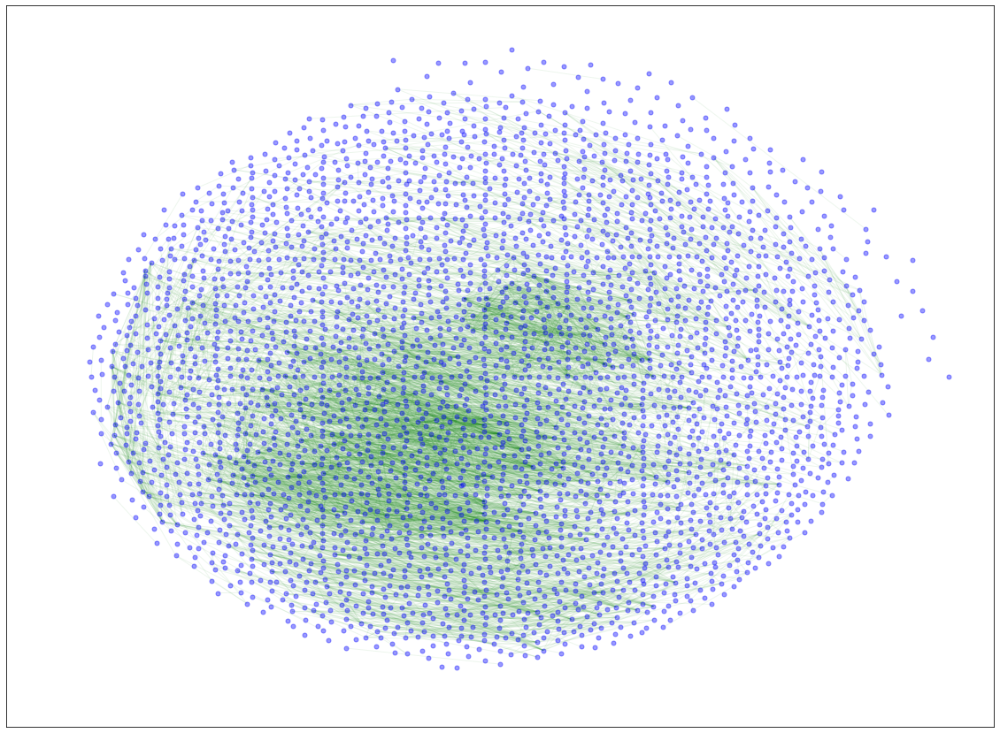

In [34]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions(number_iterations=15000)
graph_utils.draw_network()

##### Exponential a=5, b=1, top 0.05% connections

100%|██████████| 2000/2000 [05:09<00:00,  6.47it/s]


BarnesHut Approximation  took  58.19  seconds
Repulsion forces  took  101.52  seconds
Gravitational forces  took  0.63  seconds
Attraction forces  took  142.36  seconds
AdjustSpeedAndApplyForces step  took  2.74  seconds


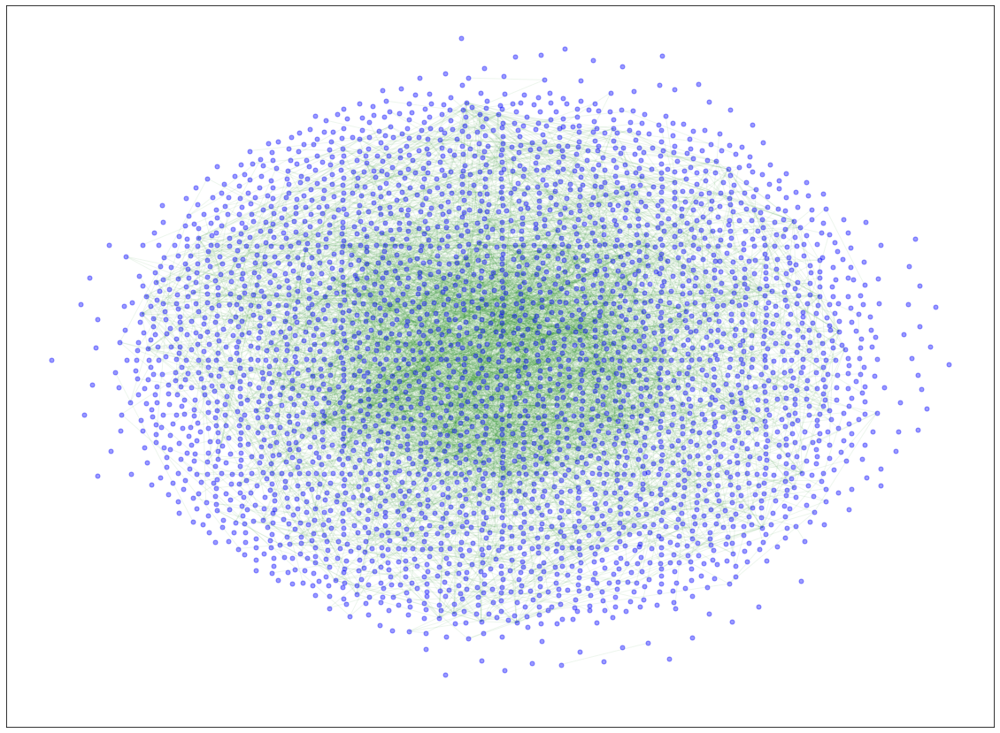

In [13]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.95)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### One_over a=1, top 0.5% connections

d:\Usuarios\Camilo\CGCNN\FA2\graph_utilities.py:121: RuntimeWarning: divide by zero encountered in true_divide
  self._adj_matrix = 1/self._diff_matrix
100%|██████████| 2000/2000 [05:53<00:00,  5.66it/s]


BarnesHut Approximation  took  53.85  seconds
Repulsion forces  took  155.85  seconds
Gravitational forces  took  0.58  seconds
Attraction forces  took  136.35  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


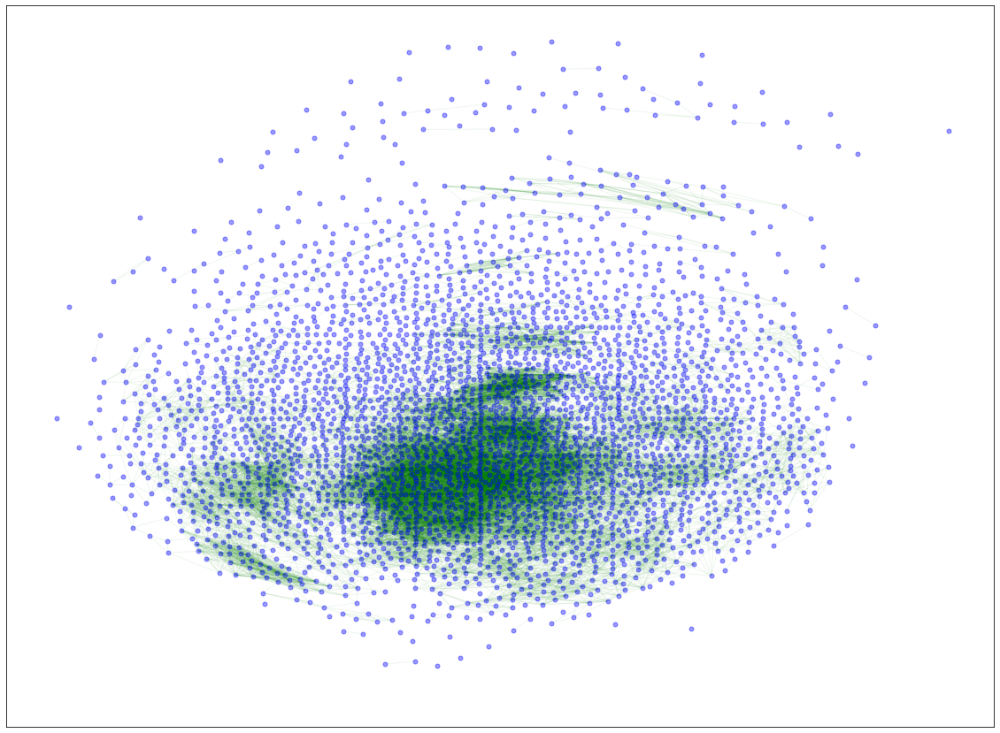

In [14]:
graph_utils.calculate_adj_matrix(method="one_over")
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.5)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### One_over a=1, top 0.3% connections

100%|██████████| 2000/2000 [05:57<00:00,  5.59it/s]


BarnesHut Approximation  took  54.44  seconds
Repulsion forces  took  159.64  seconds
Gravitational forces  took  0.60  seconds
Attraction forces  took  136.50  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


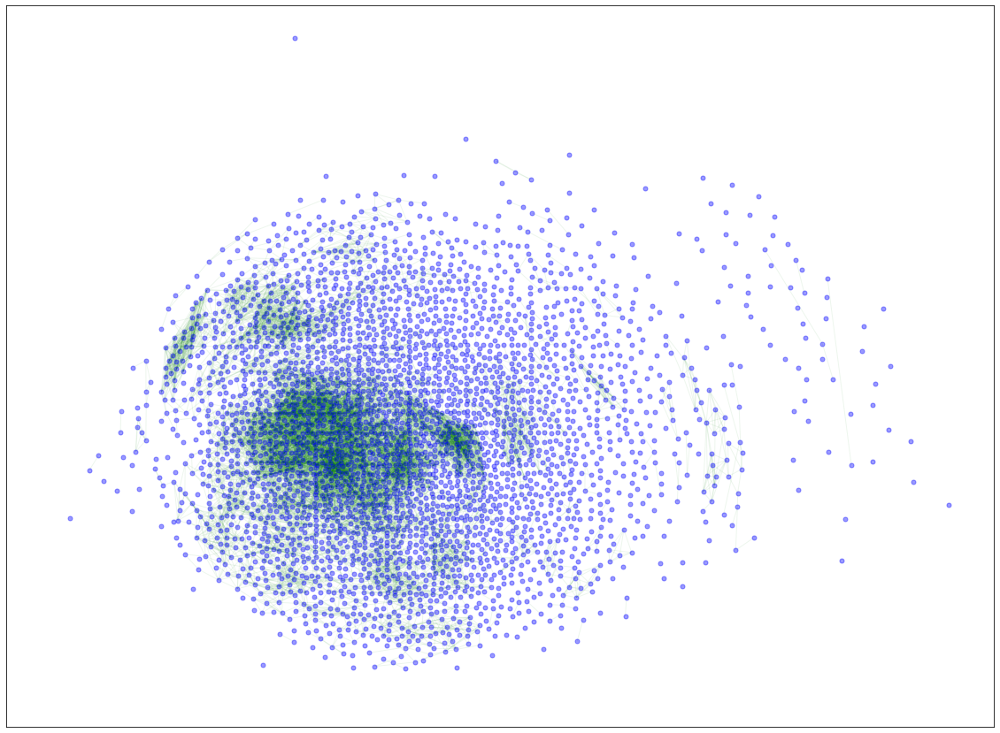

In [15]:
graph_utils.calculate_adj_matrix(method="one_over")
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.7)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### One_over a=1, top 0.1% connections

100%|██████████| 2000/2000 [05:41<00:00,  5.85it/s]


BarnesHut Approximation  took  54.34  seconds
Repulsion forces  took  144.92  seconds
Gravitational forces  took  0.58  seconds
Attraction forces  took  135.53  seconds
AdjustSpeedAndApplyForces step  took  2.67  seconds


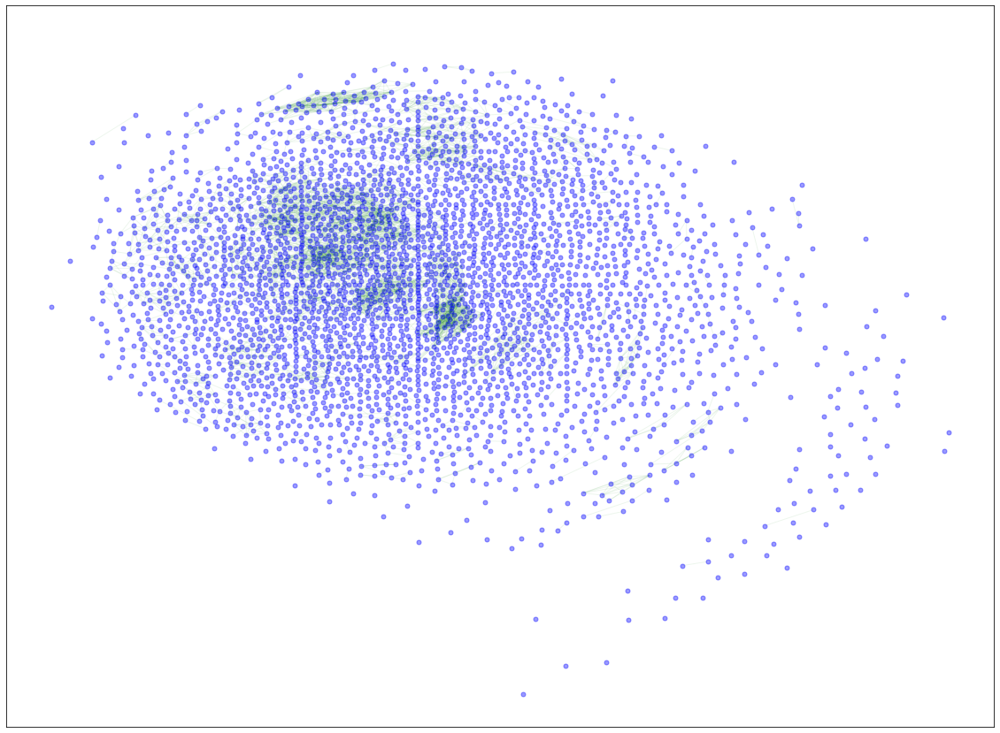

In [16]:
graph_utils.calculate_adj_matrix(method="one_over")
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### One_over a=1, top 0.05% connections

100%|██████████| 2000/2000 [05:44<00:00,  5.80it/s]


BarnesHut Approximation  took  54.34  seconds
Repulsion forces  took  147.21  seconds
Gravitational forces  took  0.59  seconds
Attraction forces  took  136.25  seconds
AdjustSpeedAndApplyForces step  took  2.70  seconds


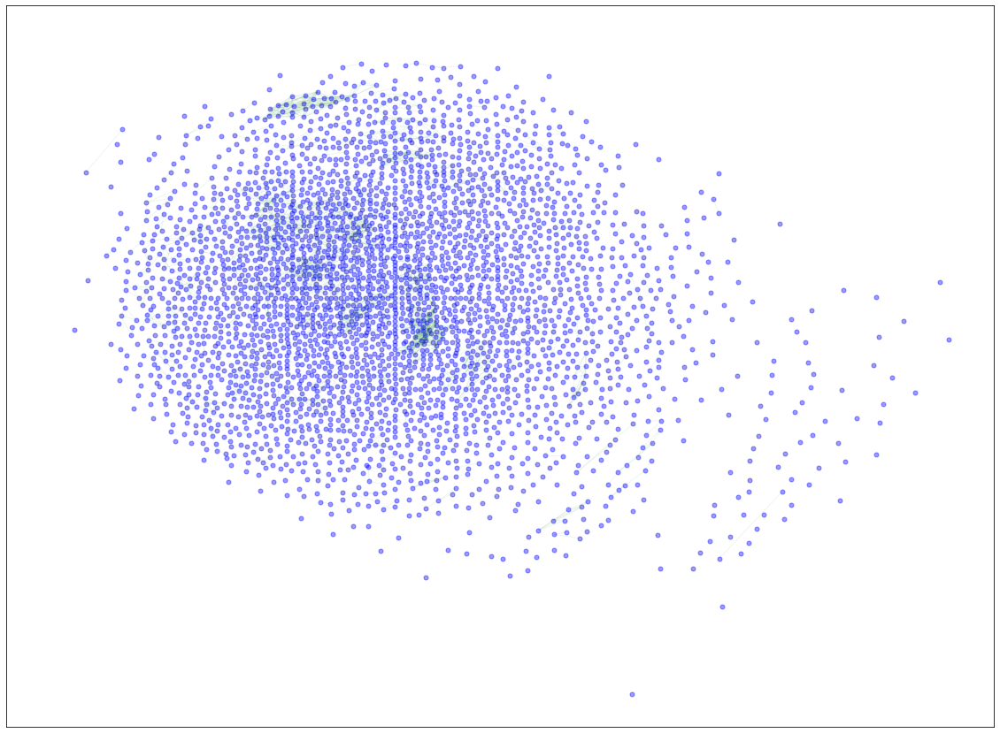

In [17]:
graph_utils.calculate_adj_matrix(method="one_over")
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.95)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=10, all connections, draw top 10%

100%|██████████| 2000/2000 [05:58<00:00,  5.58it/s]


BarnesHut Approximation  took  53.69  seconds
Repulsion forces  took  160.76  seconds
Gravitational forces  took  0.59  seconds
Attraction forces  took  136.76  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


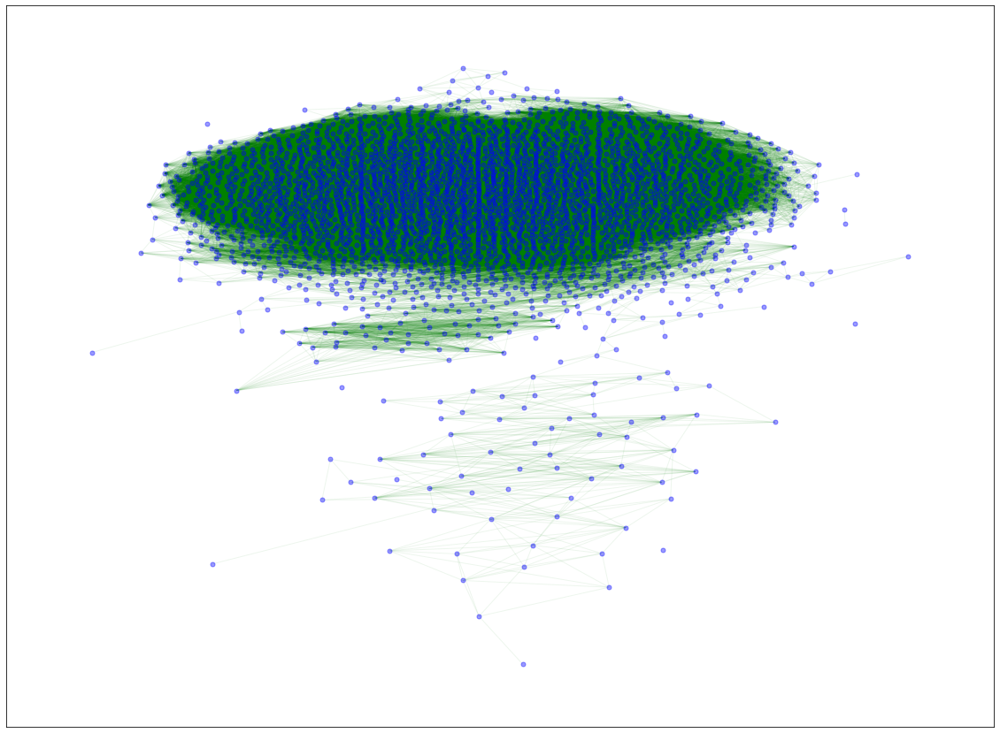

In [18]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=10)
graph_utils.calculate_fa2_node_positions()
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=90)
graph_utils.draw_network()

##### Exponential a=5, b=10, all connections, draw top 1% (previous has to run first)

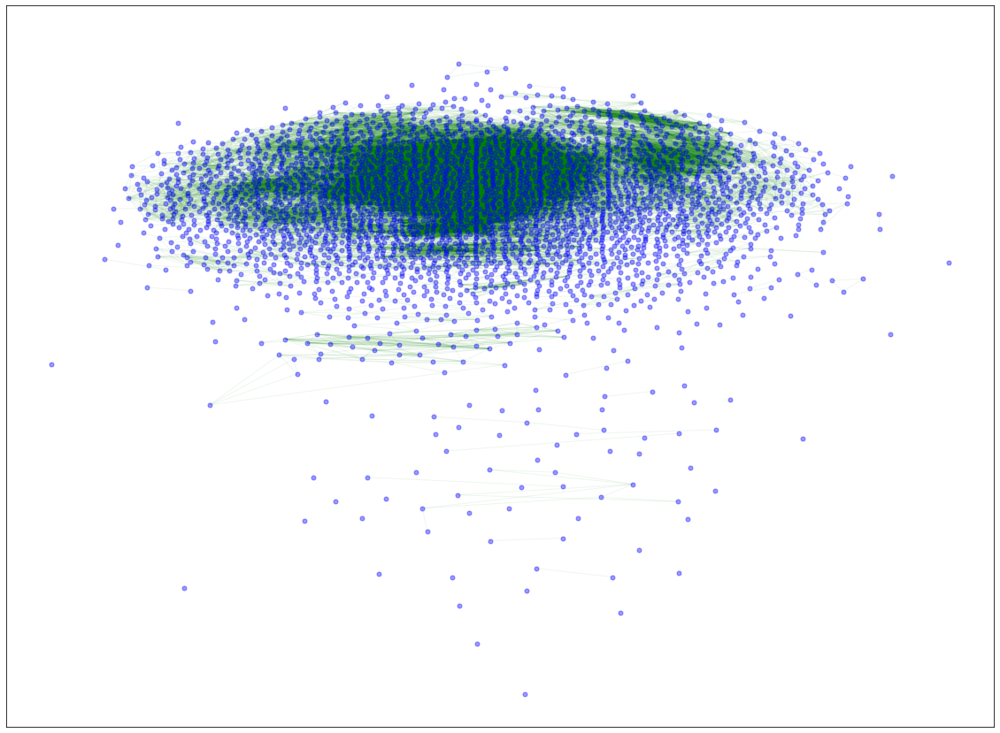

In [19]:
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99)
graph_utils.draw_network()

##### Exponential a=5, b=10, all connections, draw top 0.1% (previous has to run first)

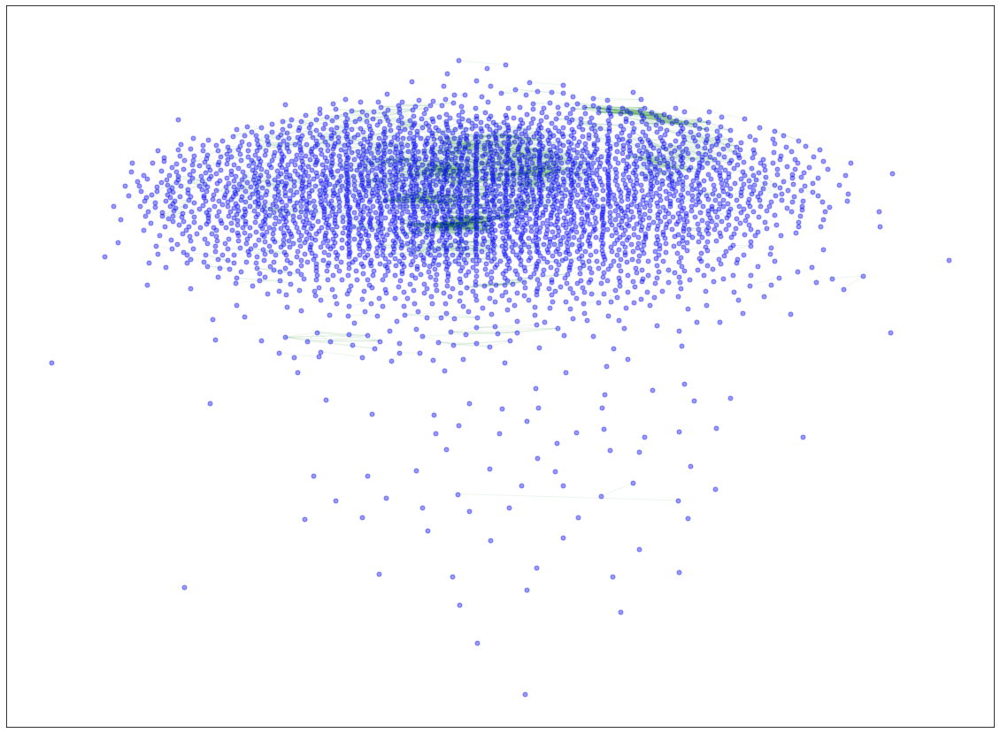

In [20]:
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.draw_network()

##### Exponential a=5, b=10, all connections, draw top 0.05% (previous has to run first)

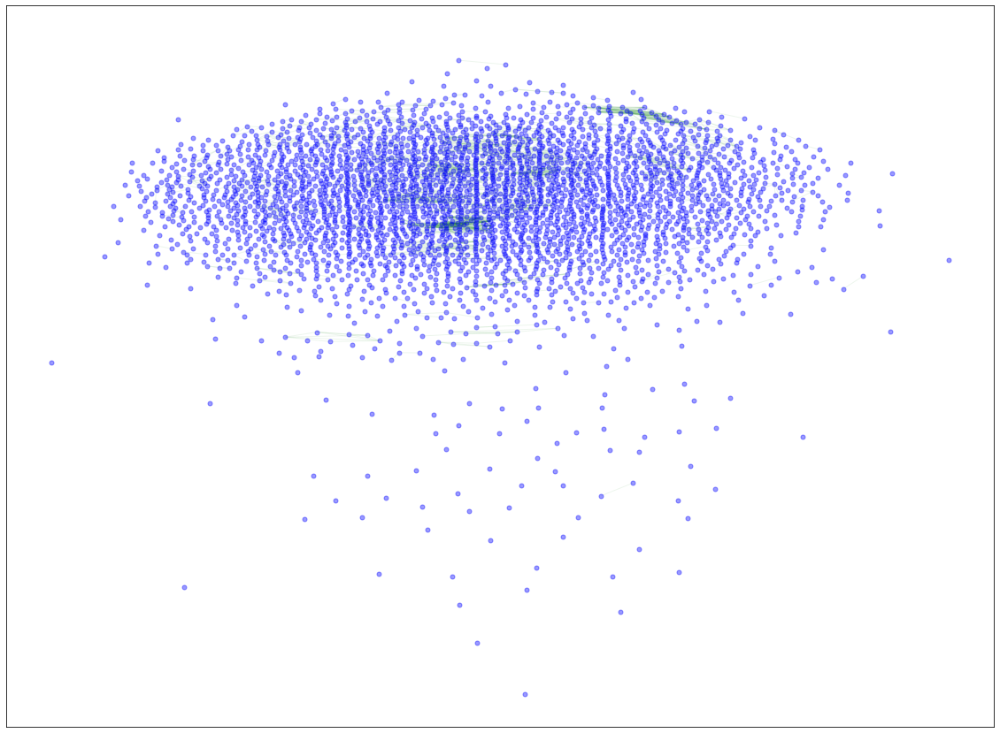

In [21]:
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.95)
graph_utils.draw_network()


##### Exponential a=5, b=30, all connections, draw top 20%

100%|██████████| 2000/2000 [06:53<00:00,  4.84it/s]


BarnesHut Approximation  took  59.56  seconds
Repulsion forces  took  184.53  seconds
Gravitational forces  took  0.58  seconds
Attraction forces  took  162.30  seconds
AdjustSpeedAndApplyForces step  took  2.64  seconds


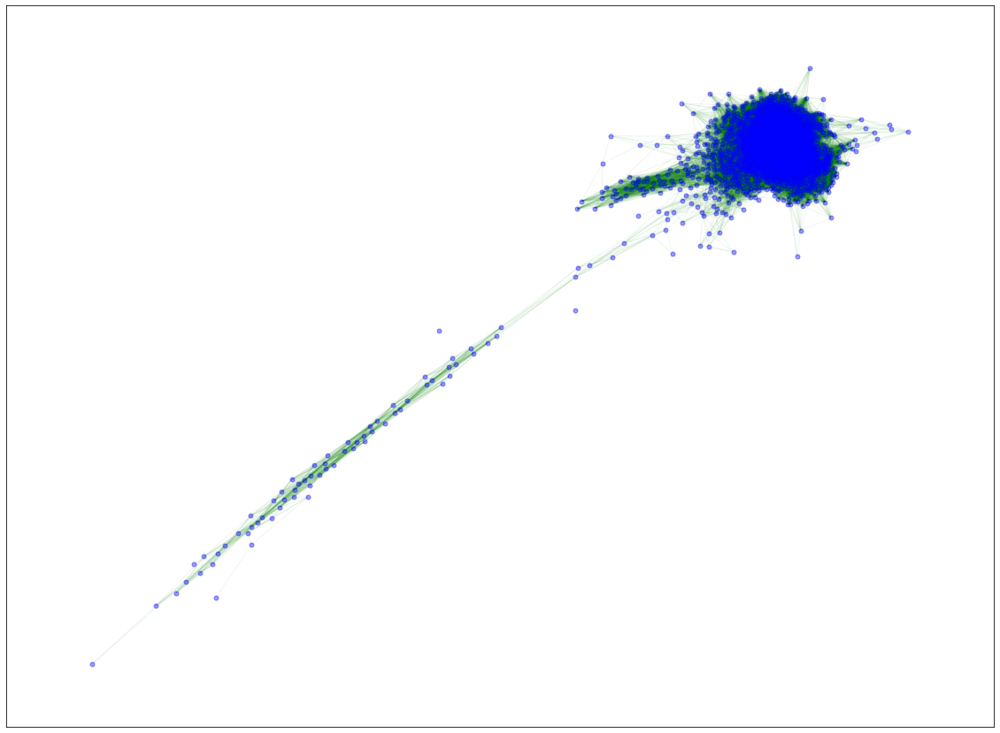

In [22]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=30)
graph_utils.calculate_fa2_node_positions()
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.draw_network()

##### Exponential a=5, b=50, all connections, draw top 10%

100%|██████████| 2000/2000 [07:10<00:00,  4.65it/s]


BarnesHut Approximation  took  64.27  seconds
Repulsion forces  took  191.70  seconds
Gravitational forces  took  0.61  seconds
Attraction forces  took  167.29  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


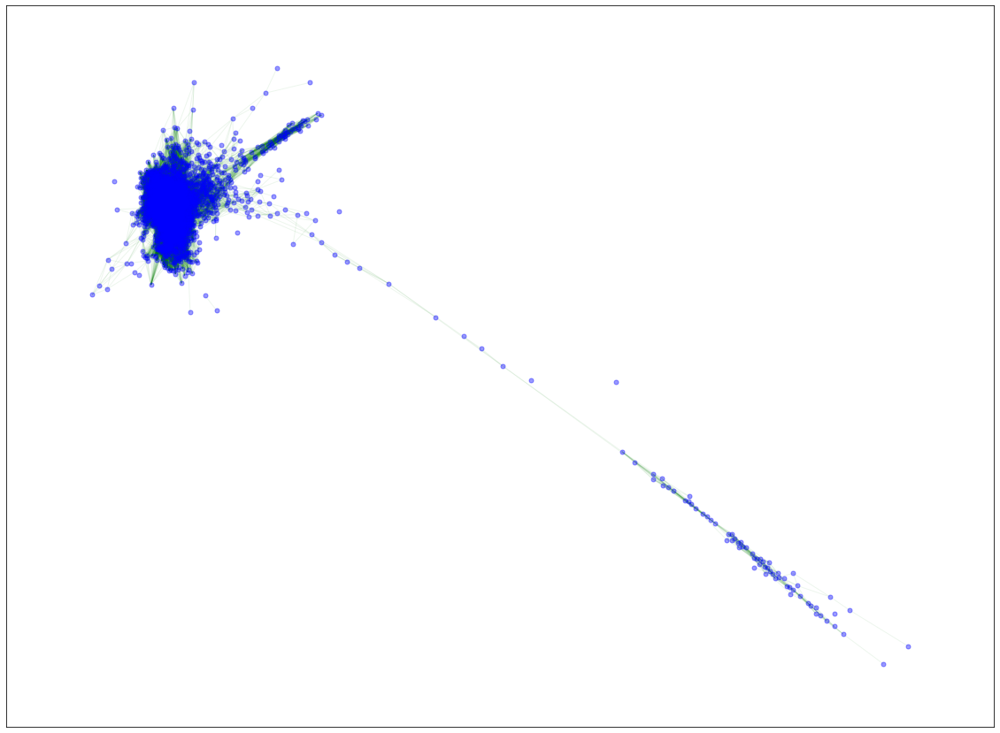

In [23]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=50)
graph_utils.calculate_fa2_node_positions()
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=90)
graph_utils.draw_network()

##### Exponential a=5, b=50, all connections, draw top 30%

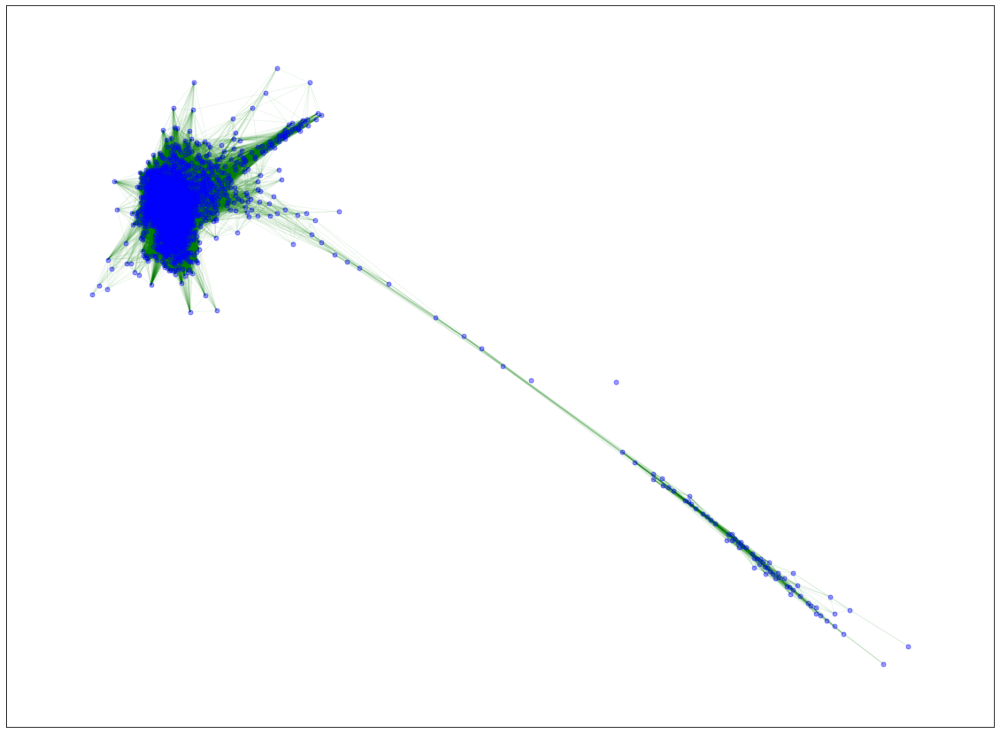

In [24]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=50)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=70)
graph_utils.draw_network()

##### Exponential a=5, b=70, all connections, draw top 20%

100%|██████████| 2000/2000 [07:55<00:00,  4.21it/s]


BarnesHut Approximation  took  71.00  seconds
Repulsion forces  took  192.81  seconds
Gravitational forces  took  0.59  seconds
Attraction forces  took  204.39  seconds
AdjustSpeedAndApplyForces step  took  2.64  seconds


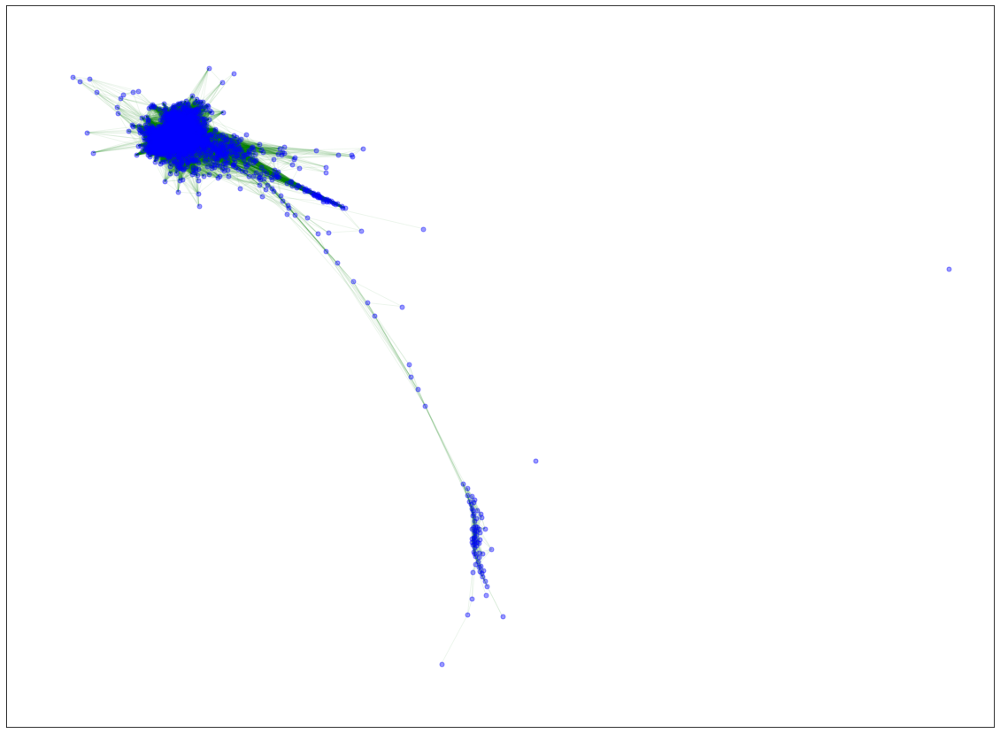

In [25]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=70)
graph_utils.calculate_fa2_node_positions()
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.draw_network()

##### Exponential a=5, b=90, all connections, draw top 20%

100%|██████████| 2000/2000 [07:37<00:00,  4.38it/s]


BarnesHut Approximation  took  64.27  seconds
Repulsion forces  took  218.41  seconds
Gravitational forces  took  0.57  seconds
Attraction forces  took  167.32  seconds
AdjustSpeedAndApplyForces step  took  2.63  seconds


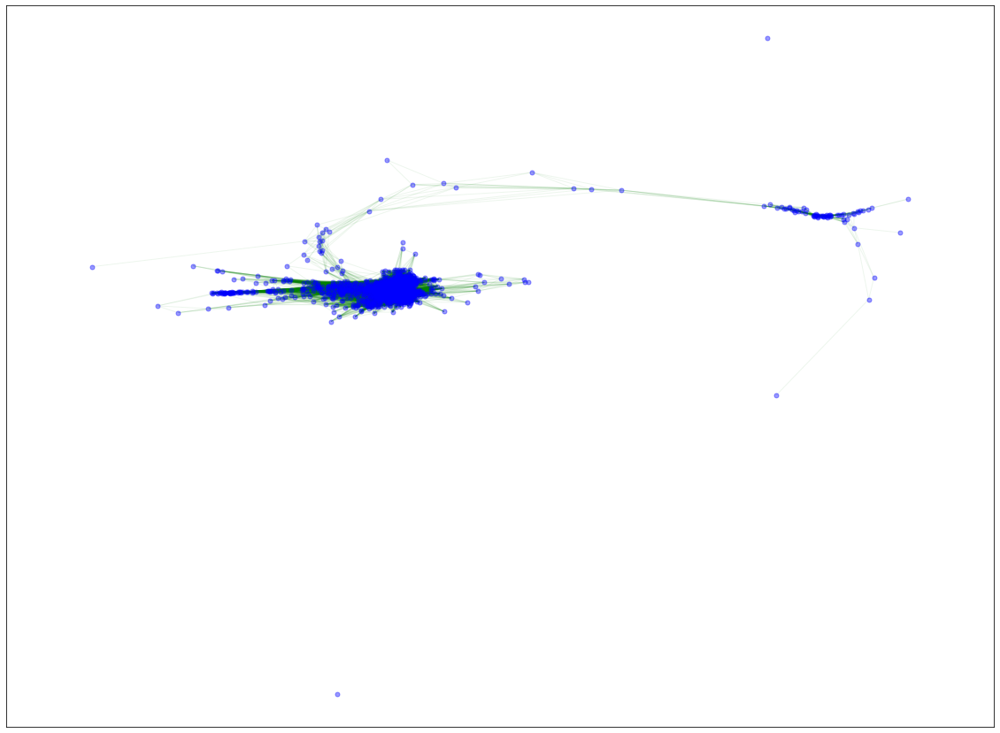

In [26]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=100)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=110, all connections, draw top 20%

100%|██████████| 2000/2000 [07:26<00:00,  4.48it/s]


BarnesHut Approximation  took  64.31  seconds
Repulsion forces  took  201.54  seconds
Gravitational forces  took  0.61  seconds
Attraction forces  took  172.94  seconds
AdjustSpeedAndApplyForces step  took  2.64  seconds


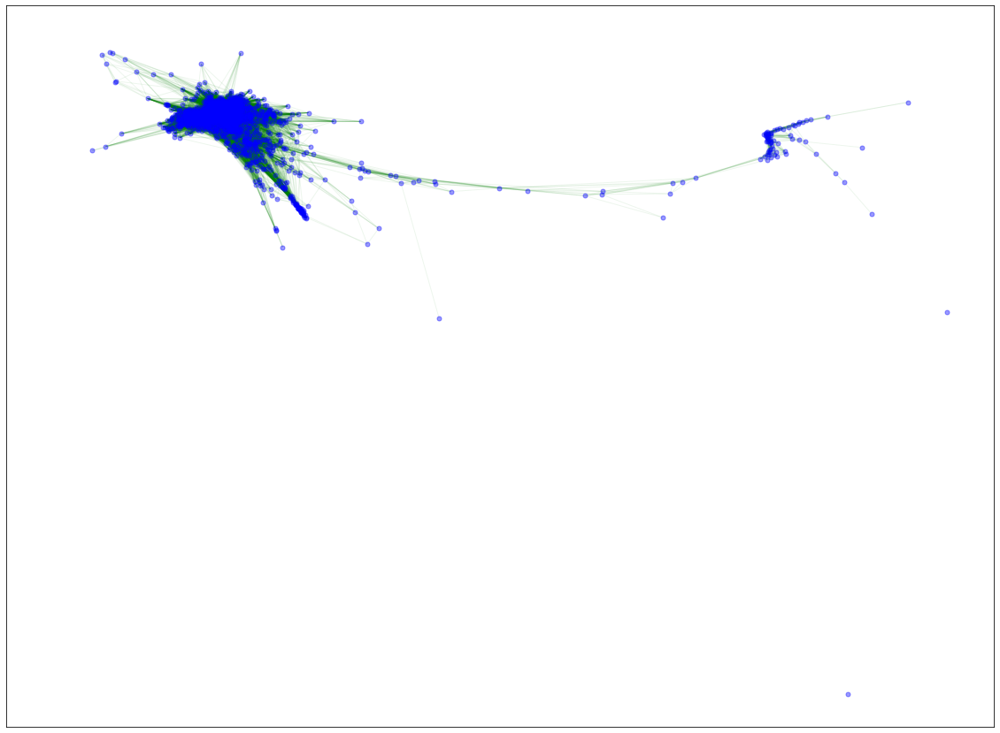

In [27]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=110)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=200, all connections, draw top 20%

100%|██████████| 2000/2000 [07:46<00:00,  4.29it/s]


BarnesHut Approximation  took  64.42  seconds
Repulsion forces  took  220.19  seconds
Gravitational forces  took  0.57  seconds
Attraction forces  took  174.48  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


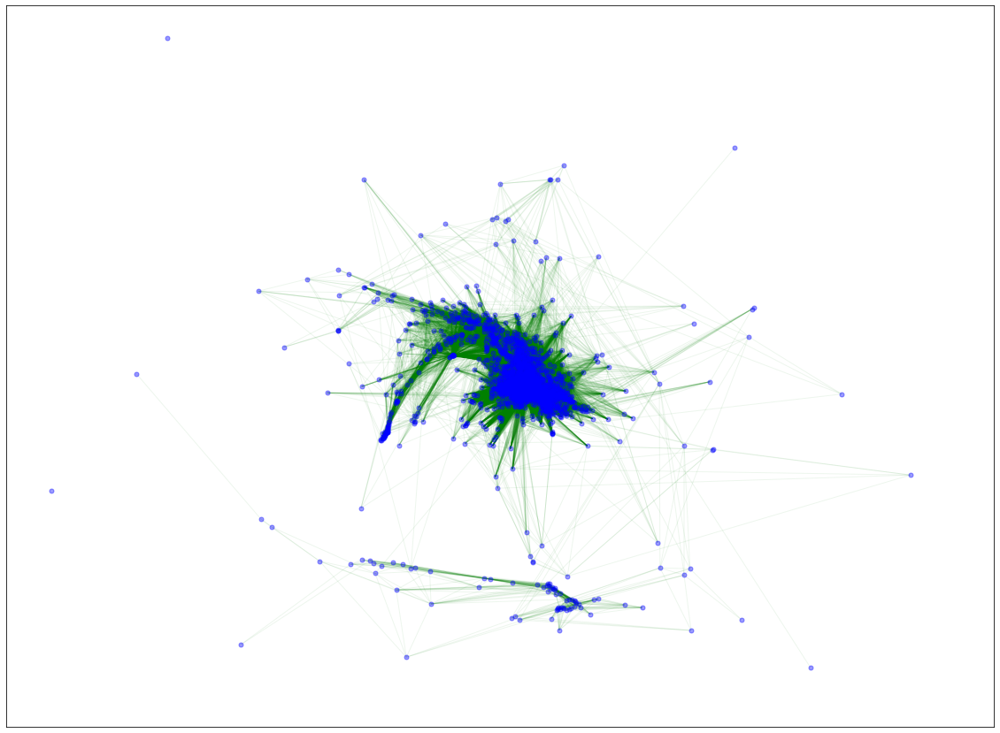

In [28]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=200)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=300, all connections, draw top 20%

100%|██████████| 2000/2000 [07:33<00:00,  4.41it/s]


BarnesHut Approximation  took  66.15  seconds
Repulsion forces  took  204.57  seconds
Gravitational forces  took  0.59  seconds
Attraction forces  took  176.06  seconds
AdjustSpeedAndApplyForces step  took  2.66  seconds


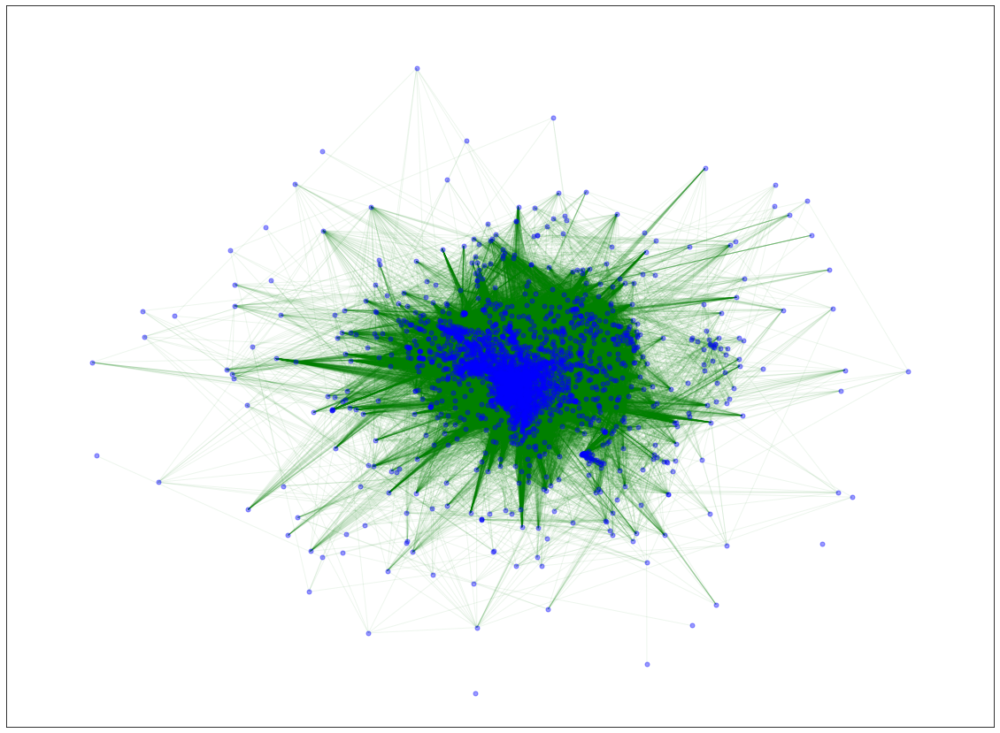

In [29]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=300)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=400, all connections, draw top 20%

100%|██████████| 2000/2000 [06:44<00:00,  4.94it/s]


BarnesHut Approximation  took  66.38  seconds
Repulsion forces  took  162.49  seconds
Gravitational forces  took  0.59  seconds
Attraction forces  took  168.78  seconds
AdjustSpeedAndApplyForces step  took  2.68  seconds


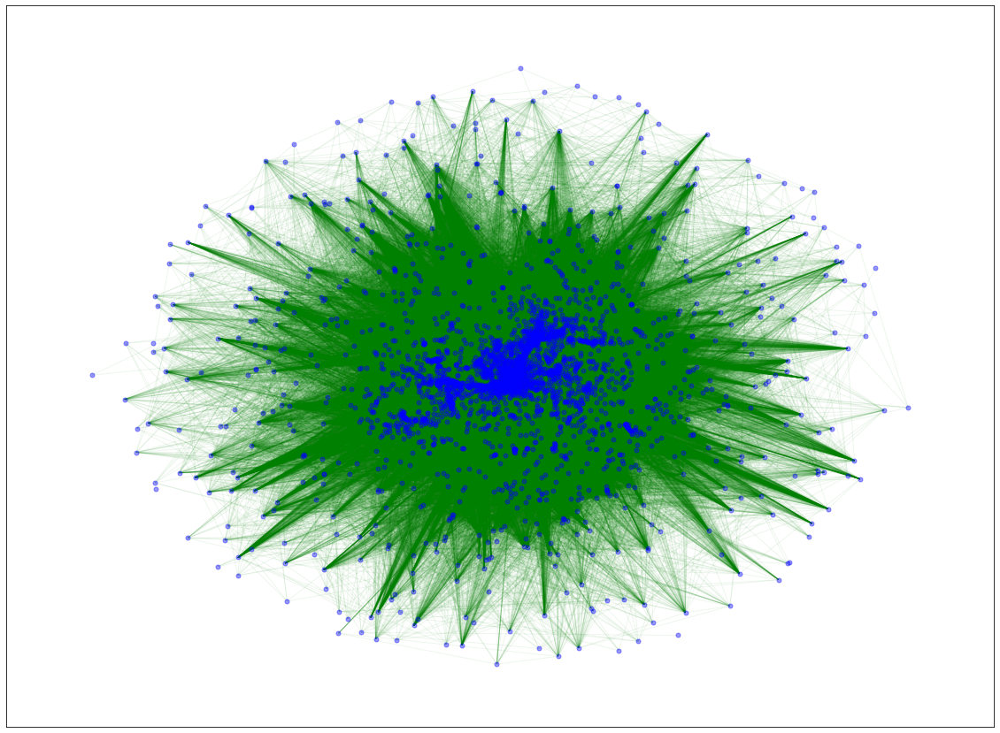

In [30]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=400)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=500, all connections, draw top 20%

100%|██████████| 2000/2000 [05:28<00:00,  6.09it/s]


BarnesHut Approximation  took  57.08  seconds
Repulsion forces  took  126.60  seconds
Gravitational forces  took  0.60  seconds
Attraction forces  took  137.60  seconds
AdjustSpeedAndApplyForces step  took  2.61  seconds


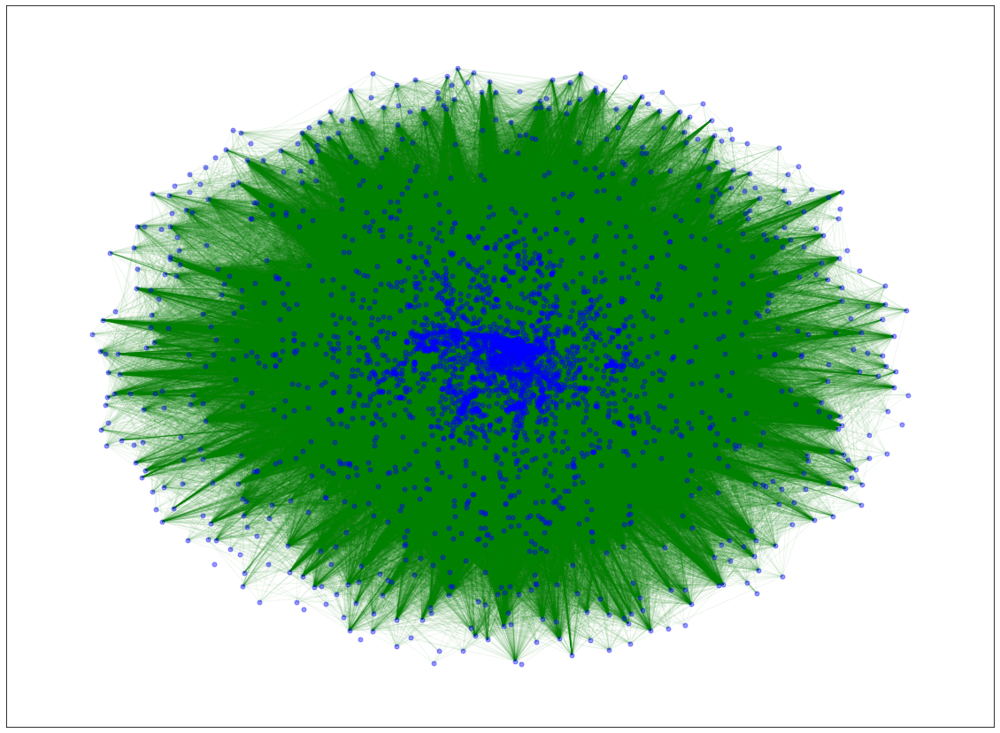

In [35]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=500)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=600, top 10% connections

100%|██████████| 2000/2000 [06:13<00:00,  5.35it/s]


BarnesHut Approximation  took  69.54  seconds
Repulsion forces  took  119.63  seconds
Gravitational forces  took  0.67  seconds
Attraction forces  took  177.40  seconds
AdjustSpeedAndApplyForces step  took  2.81  seconds


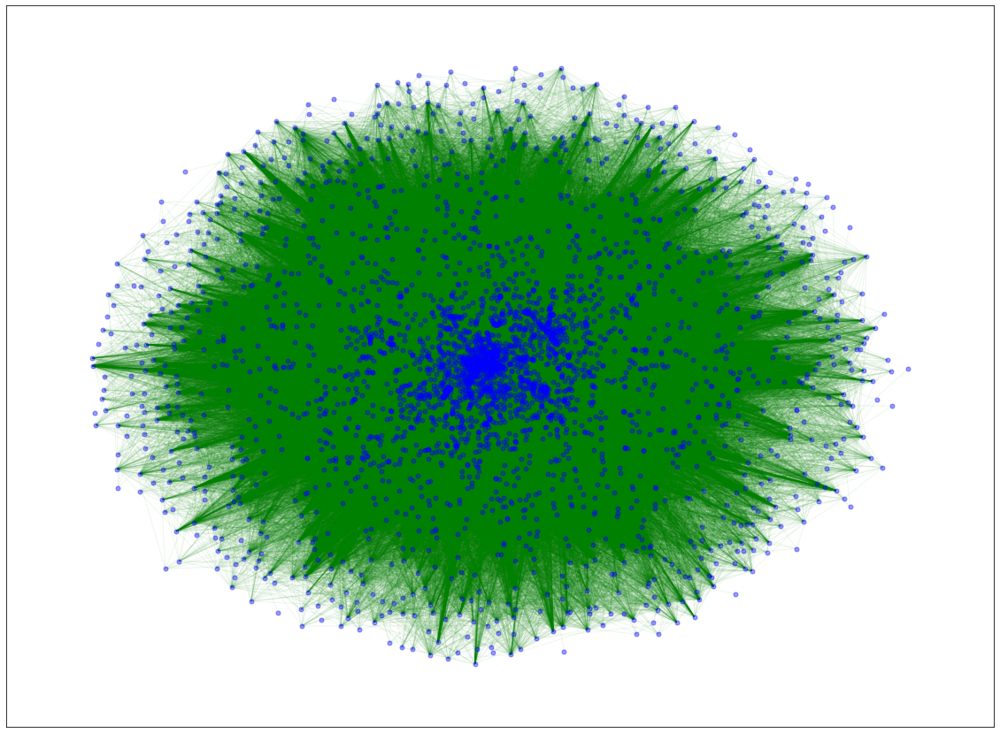

In [36]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=600)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=90)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=700, top 1% connections

100%|██████████| 2000/2000 [05:38<00:00,  5.92it/s]


BarnesHut Approximation  took  63.91  seconds
Repulsion forces  took  108.65  seconds
Gravitational forces  took  0.61  seconds
Attraction forces  took  158.20  seconds
AdjustSpeedAndApplyForces step  took  2.73  seconds


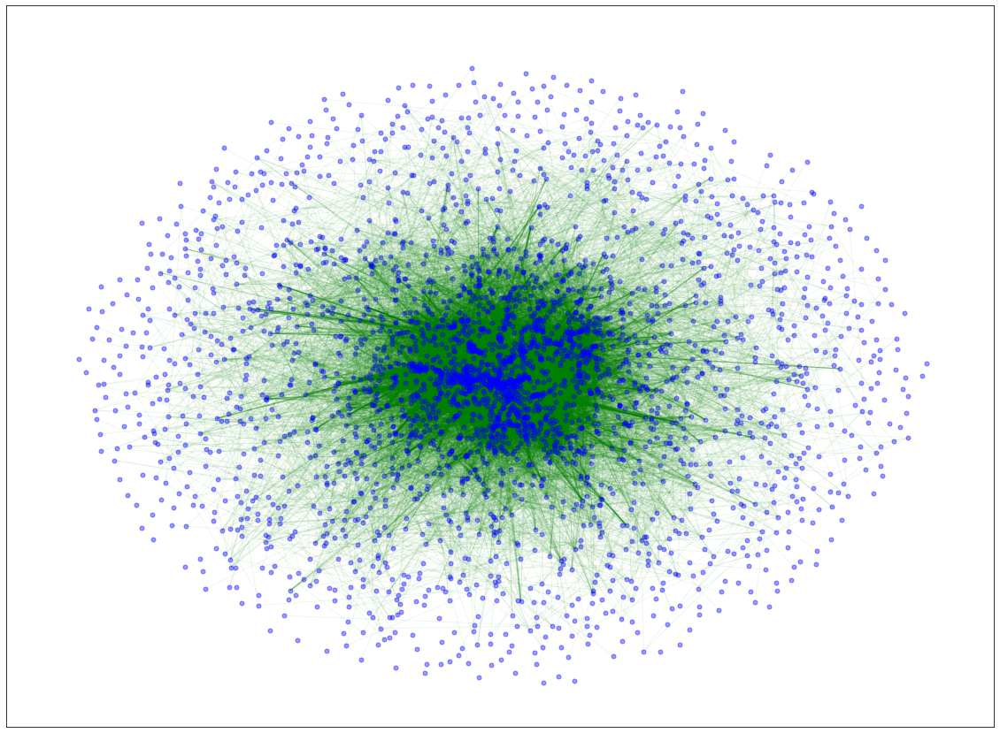

In [37]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=700)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=800, top 0.5% connections

100%|██████████| 2000/2000 [05:41<00:00,  5.86it/s]


BarnesHut Approximation  took  68.88  seconds
Repulsion forces  took  111.71  seconds
Gravitational forces  took  0.71  seconds
Attraction forces  took  152.65  seconds
AdjustSpeedAndApplyForces step  took  3.00  seconds


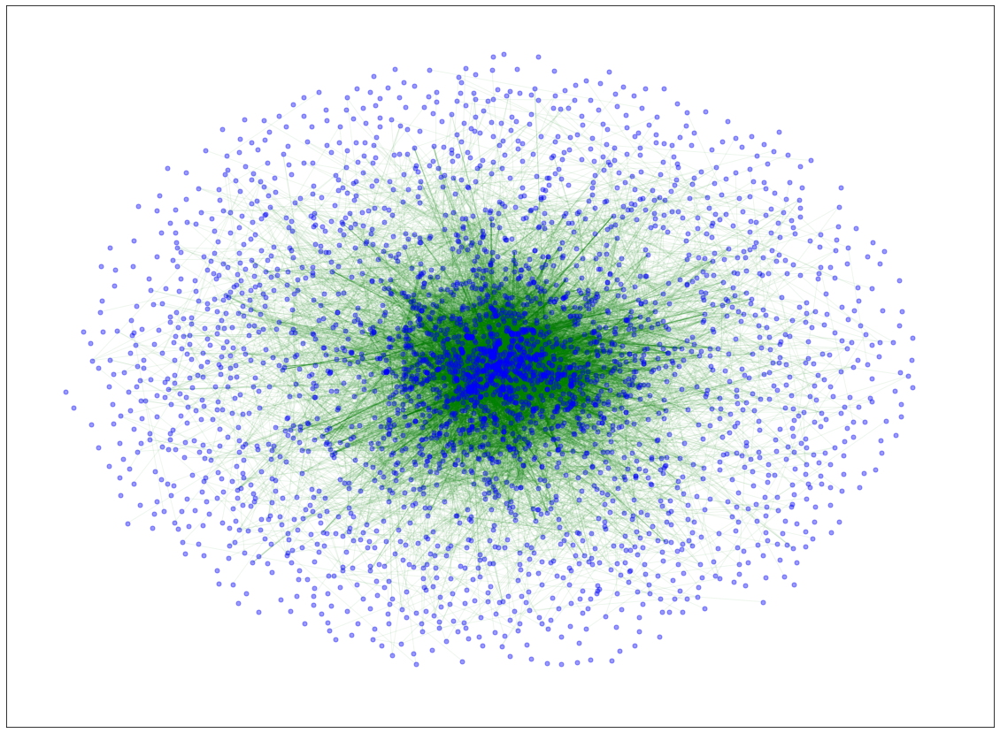

In [38]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=800)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.5)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=1000, top 0.1% connections

100%|██████████| 2000/2000 [05:26<00:00,  6.13it/s]


BarnesHut Approximation  took  64.27  seconds
Repulsion forces  took  107.40  seconds
Gravitational forces  took  0.73  seconds
Attraction forces  took  146.61  seconds
AdjustSpeedAndApplyForces step  took  3.00  seconds


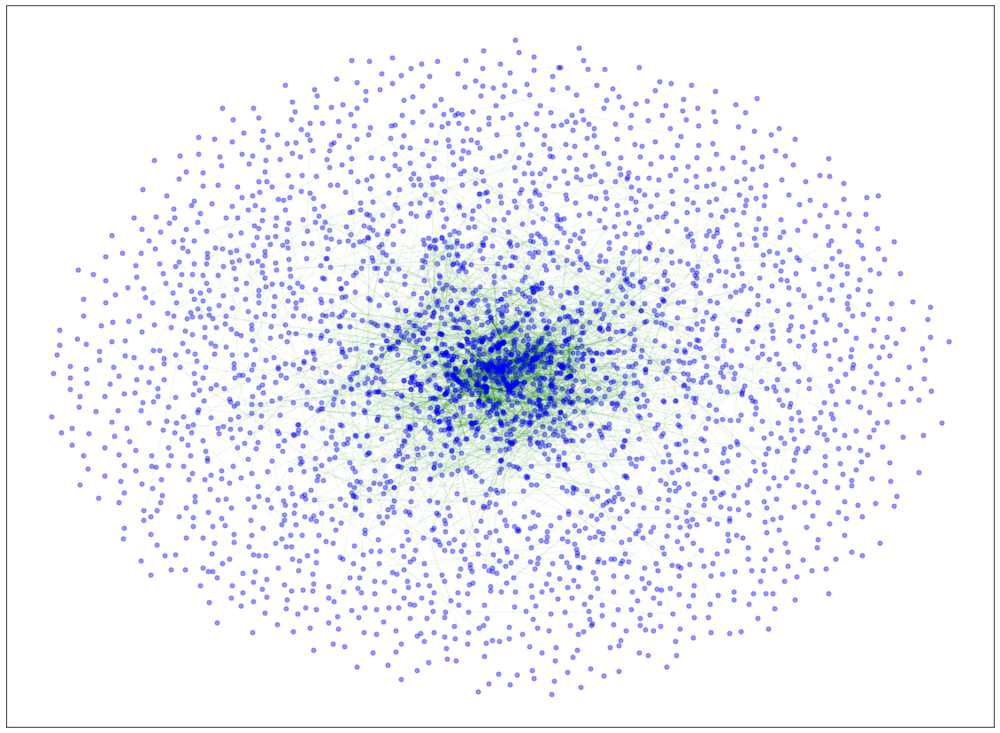

In [39]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=1000)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99.9)
graph_utils.calculate_fa2_node_positions()
graph_utils.draw_network()

##### Exponential a=5, b=500, all connections, draw top 20%, 6000 iterations

100%|██████████| 6000/6000 [20:25<00:00,  4.89it/s]


BarnesHut Approximation  took  197.64  seconds
Repulsion forces  took  477.55  seconds
Gravitational forces  took  1.73  seconds
Attraction forces  took  529.42  seconds
AdjustSpeedAndApplyForces step  took  8.00  seconds


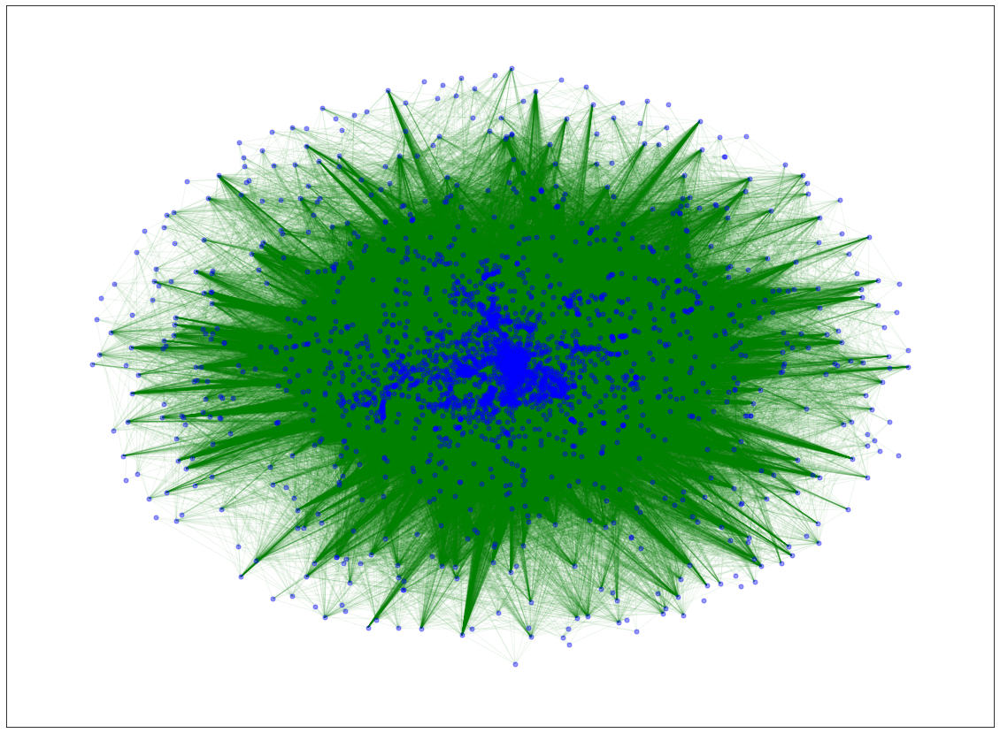

In [32]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=500)
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=80)
graph_utils.calculate_fa2_node_positions(number_iterations=6000)
graph_utils.draw_network()

## One_over top 0.1% connections analysis

In [39]:
graph_utils.calculate_adj_matrix()
graph_utils.apply_mask_to_adj_matrix(weights_filter_percentile=99)
adj_matrix = graph_utils.get_adj_matrix()

number_connections_per_material = sorted(list(zip((adj_matrix != 0).astype(int).sum().index, (adj_matrix != 0).astype(int).sum())), key=lambda item: item[1], reverse=True)
print("Material with most connections: ", number_connections_per_material[0])

d:\Usuarios\Camilo\CGCNN\FA2\graph_utilities.py:121: RuntimeWarning:

divide by zero encountered in true_divide



Material with most connections:  ('mp-1076961', 243)


In [41]:
import matplotlib.pyplot as plt

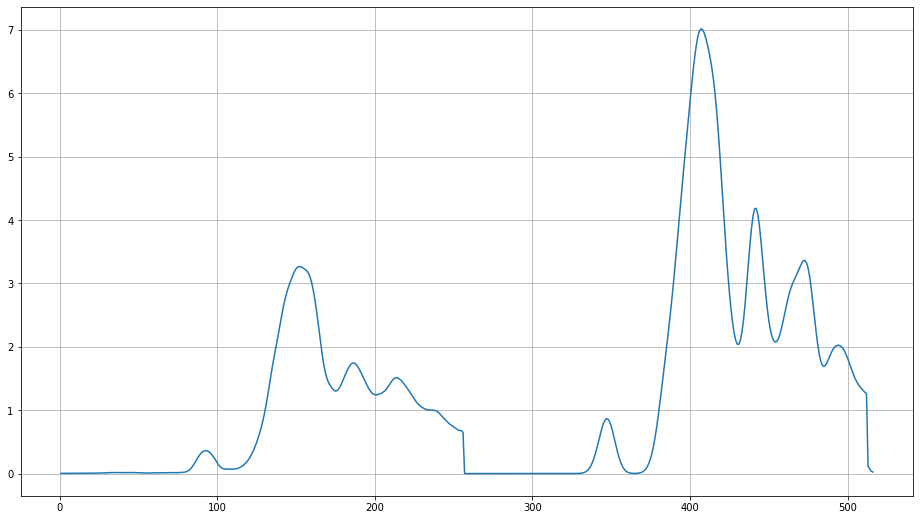

In [42]:
plt.figure(figsize=(16,9))
dataset["mp-1076961"].plot()
plt.grid()
plt.show()

In [43]:
adj_matrix["mp-1076961"][adj_matrix["mp-1076961"] != 0].sort_values()

0
mp-1025495    0.159021
mp-1220572    0.159321
mp-1206354    0.159353
mp-8743       0.159500
mp-1078854    0.159653
                ...   
mp-5939       0.354587
mp-1101953    0.367147
mp-1768       0.376675
mp-1102565    0.394276
mp-977354     0.407791
Name: mp-1076961, Length: 243, dtype: float64

In [47]:
import matplotlib.pyplot as plt

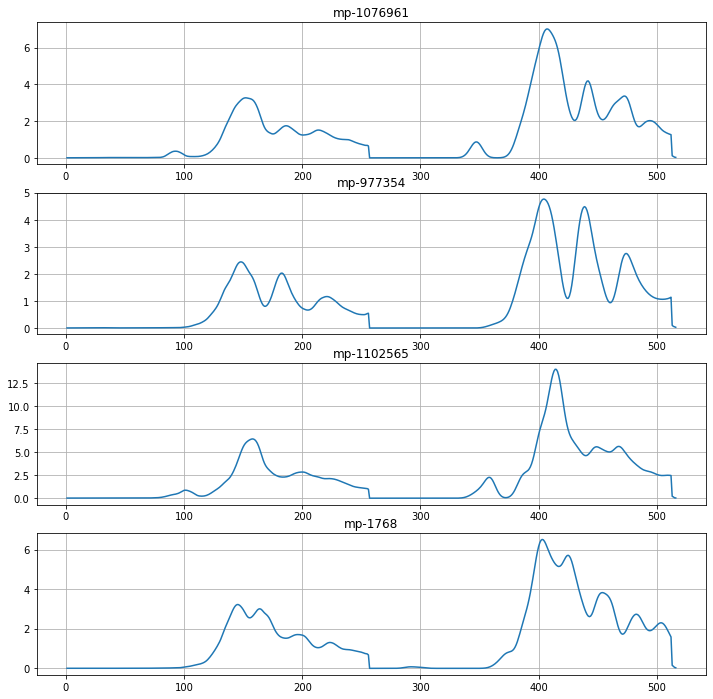

In [44]:
plt.figure(figsize=(12,12))

plt.subplot(4, 1, 1)
plt.plot(dataset["mp-1076961"])
plt.grid()
plt.title("mp-1076961")

plt.subplot(4, 1, 2)
plt.plot(dataset["mp-977354"])
plt.grid()
plt.title("mp-977354")

plt.subplot(4, 1, 3)
plt.plot(dataset["mp-1102565"])
plt.grid()
plt.title("mp-1102565")

plt.subplot(4, 1, 4)
plt.plot(dataset["mp-1768"])
plt.grid()
plt.title("mp-1768")

plt.show()

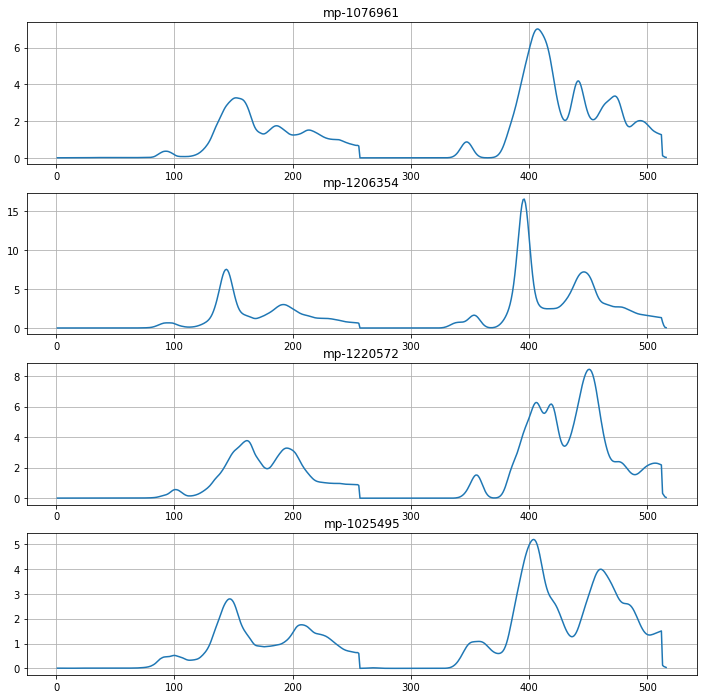

In [45]:
plt.figure(figsize=(12,12))

plt.subplot(4, 1, 1)
plt.plot(dataset["mp-1076961"])
plt.grid()
plt.title("mp-1076961")

plt.subplot(4, 1, 2)
plt.plot(dataset["mp-1206354"])
plt.grid()
plt.title("mp-1206354")

plt.subplot(4, 1, 3)
plt.plot(dataset["mp-1220572"])
plt.grid()
plt.title("mp-1220572")

plt.subplot(4, 1, 4)
plt.plot(dataset["mp-1025495"])
plt.grid()
plt.title("mp-1025495")

plt.show()

## Extract all difference values and adjacency values and graph them

In [47]:
import numpy as np

In [62]:
graph_utils.calculate_diff_matrix()

100%|██████████| 3450/3450 [00:34<00:00, 99.24it/s] 


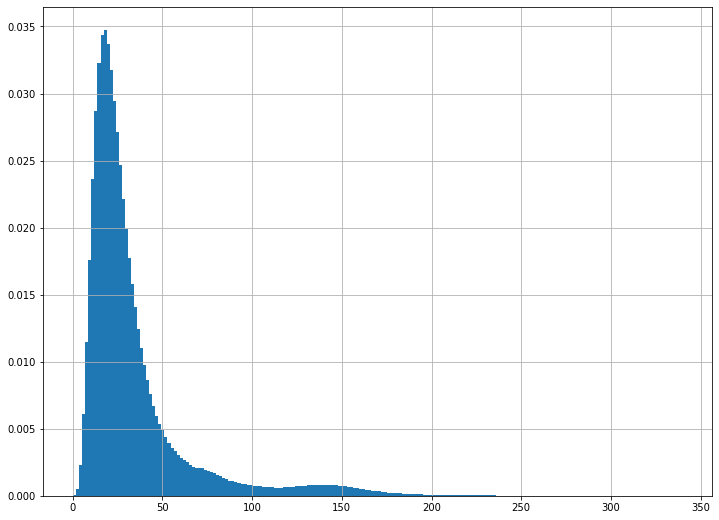

In [114]:
diff_matrix_df = graph_utils.get_diff_matrix()
diff_matrix = diff_matrix_df.to_numpy()
diff_matrix_values = diff_matrix[np.triu_indices(diff_matrix.shape[0], k = 1)]

plt.figure(figsize=(12,9))
plt.hist(diff_matrix_values, density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

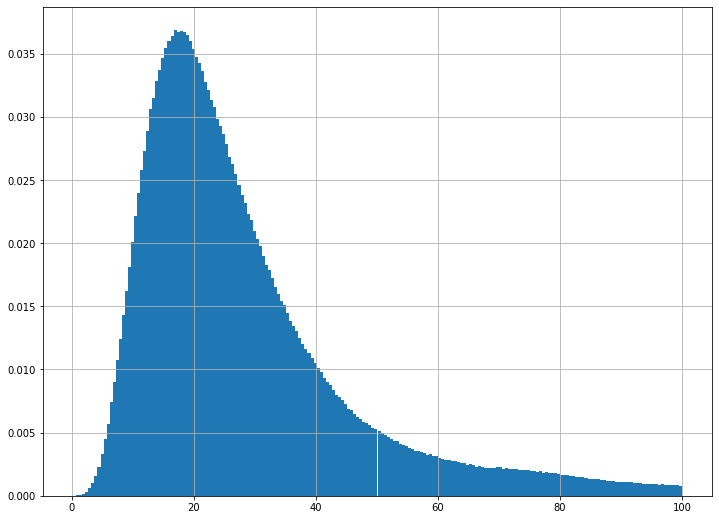

In [113]:
plt.figure(figsize=(12,9))
plt.hist(diff_matrix_values[diff_matrix_values < 100], density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

d:\Usuarios\Camilo\CGCNN\FA2\graph_utilities.py:117: RuntimeWarning:

divide by zero encountered in true_divide



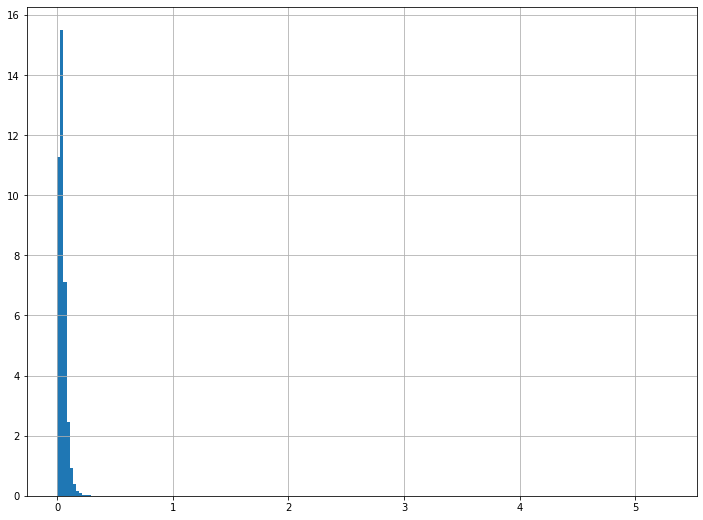

In [112]:
graph_utils.calculate_adj_matrix()
adj_matrix_df = graph_utils.get_adj_matrix()
adj_matrix = adj_matrix_df.to_numpy()
adj_matrix_values = adj_matrix[np.triu_indices(adj_matrix.shape[0], k = 1)]

plt.figure(figsize=(12,9))
plt.hist(adj_matrix_values, density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

In [71]:
print("Max of adj. matrix: " + str(adj_matrix_values.max()) + ", and min of adj. matrix: " + str(adj_matrix_values.min()))

Max of adj. matrix: 5.266417468817696, and min of adj. matrix: 0.002945015369736446


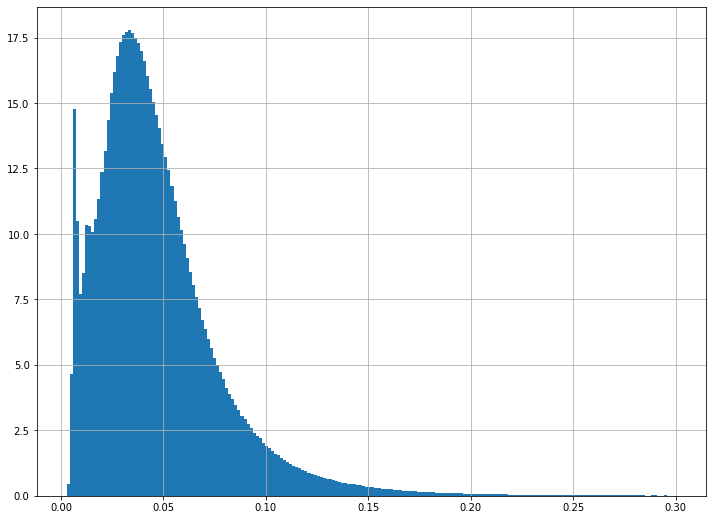

In [111]:
plt.figure(figsize=(12,9))
plt.hist(adj_matrix_values[adj_matrix_values < 0.3], density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

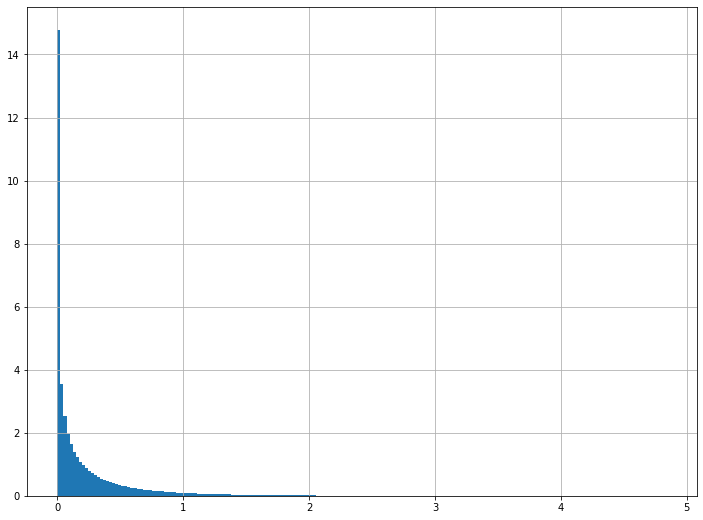

In [48]:
graph_utils.calculate_adj_matrix(method="exponential", a_exponential=5, b_exponential=90)
adj_matrix_df = graph_utils.get_adj_matrix()
adj_matrix = adj_matrix_df.to_numpy()
adj_matrix_values = adj_matrix[np.triu_indices(adj_matrix.shape[0], k = 1)]

plt.figure(figsize=(12,9))
plt.hist(adj_matrix_values, density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

In [ ]:
plt.figure(figsize=(12,9))
plt.hist(adj_matrix_values[adj_matrix_values < 0.3], density=True, bins=200)  # density=False would make counts
plt.grid()
plt.show()

## Analyse ten random materials

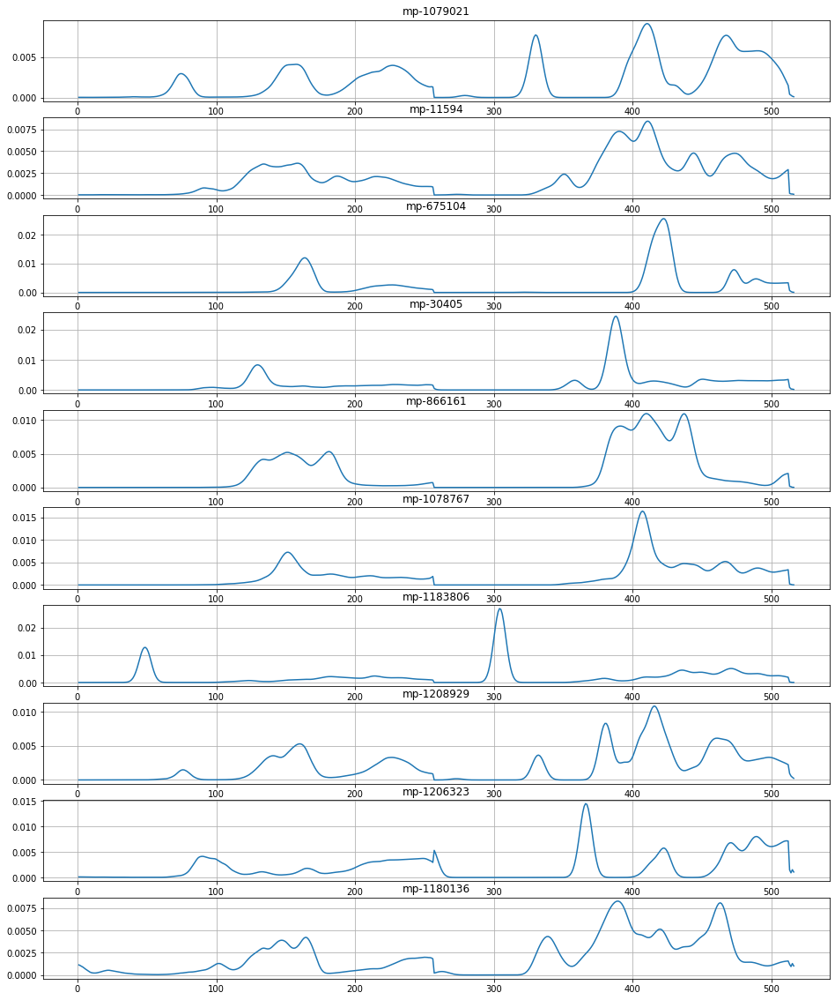

In [5]:
graph_utils.draw_sample_materials(number=10, random_state=1)